# 2.0-snuffelfiets-plots
Contains the code used to create the plots in the Snuffelfiets study.

In [1]:
# Import packages
import pandas as pd 
import numpy as np 
import geopandas as gpd 
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter

from tqdm import tqdm

import plotly.express as px
from collections import Counter
import glob
import math
import re


In [11]:
# import Snuffelfiets data

df = pd.read_csv("../data/interim/full_city_jan_2020_bbox.csv")
df['recording_time'] = pd.to_datetime(df['recording_time'], format="%Y-%m-%d %H:%M:%S")


gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['lon'],df['lat'], crs="EPSG:4326"))
gdf = gdf.to_crs("EPSG:28992")


Text(0.5, 241.2528711413555, 'latitude')

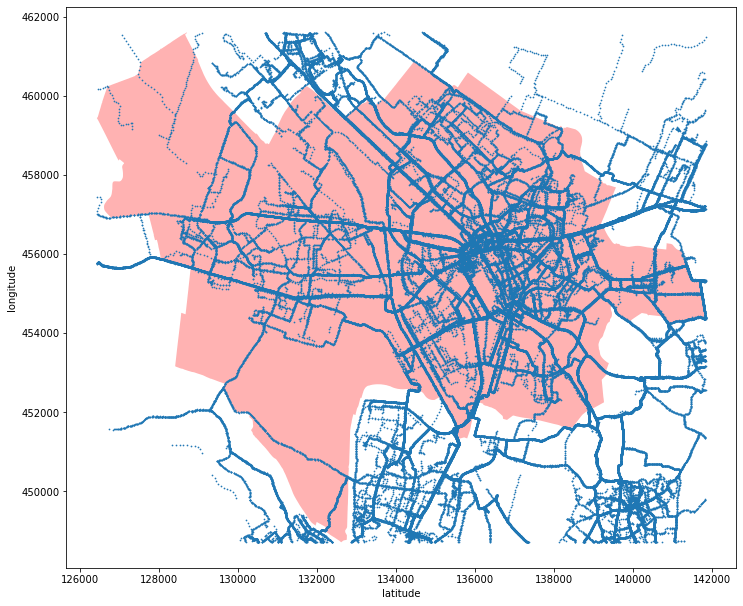

In [46]:
# Figure A2

f, ax = plt.subplots(1, figsize=(12, 15))
utrecht.plot(ax=ax, color="red", alpha=0.3)
gdf.plot(ax=ax, markersize=0.5)
ax.set_ylabel('longitude')
ax.set_xlabel('latitude')

f.savefig("../reports/figures/sf_jan2020_plot.png")

In [12]:
# Add new variables to the data

gdf["date"] = gdf['recording_time'].dt.date
gdf["hour"] = gdf["recording_time"].dt.hour
gdf["week"] = gdf["recording_time"].dt.week

gdf["datehour"] = pd.to_datetime(gdf["date"]) + gdf["hour"].astype('timedelta64[h]')
gdf['day_of_week'] = gdf['recording_time'].dt.day_name()


<ipython-input-12-36dcf8022a52>:5: FutureWarning:

Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.



In [13]:
# Figure A1

count = Counter([date for date in gdf["datehour"][(gdf["week"]==2)|(gdf["week"]==3)]])

activity = pd.DataFrame.from_dict(count, orient='index', columns=["activity"]).reset_index().sort_values(by=['index'])

fig = px.line(activity, x='index', y='activity', title='Snuffelfiets activity per hour in January 2020')
fig.show()

In [14]:
config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 960,
            'width': 1280,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }

In [15]:
fig = px.line(activity, x='index', y='activity', labels={
                "index": "Date",  "activity": "Number of measurements"
            }, template="plotly_white")

fig.update_traces(line=dict(width=3.5))

fig.show(config=config)

In [10]:
fig.write_image("fig1.svg")

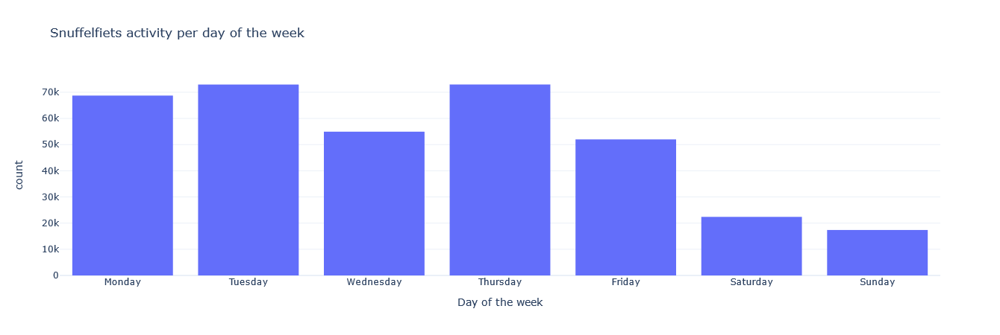

In [11]:
fig = px.histogram(gdf, x='day_of_week', title='Snuffelfiets activity per day of the week', template="plotly_white", 
            category_orders={ 
                "day_of_week": ["Monday","Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
            },
            labels={ # replaces default labels by column name
                "day_of_week": "Day of the week"
            },)
            
fig.show()

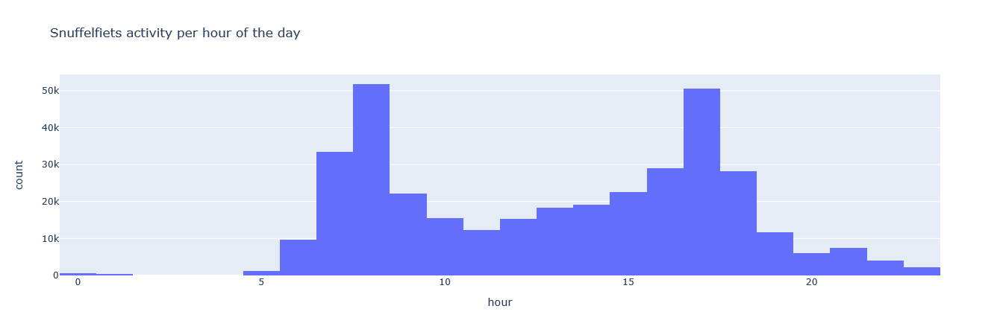

In [12]:
fig = px.histogram(gdf, x='hour', title='Snuffelfiets activity per hour of the day')
fig.show()

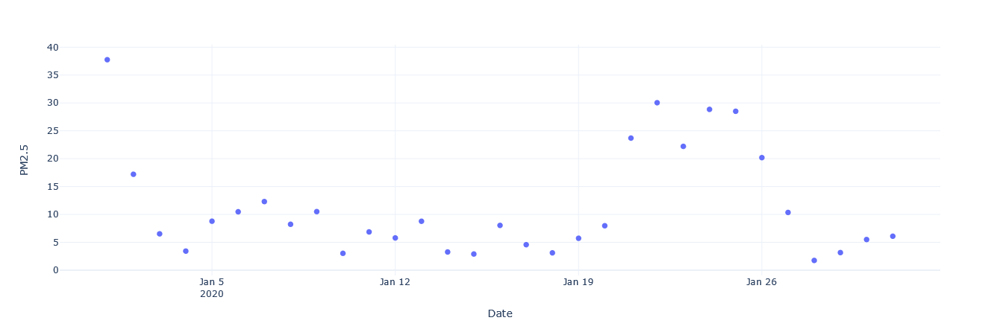

In [146]:
# Daily mean PM2.5 concentration

mean_pm25_date = gdf[["date", "pm2_5"]].groupby(["date"]).mean()

fig = px.scatter(mean_pm25_date, x=mean_pm25_date.index, y='pm2_5', labels={
                "date": "Date",  "pm2_5": "PM2.5"
            }, template="plotly_white")

fig.update_traces(marker=dict(size=7.5))

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 480,
            'width': 840,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }

fig.show(config=config)


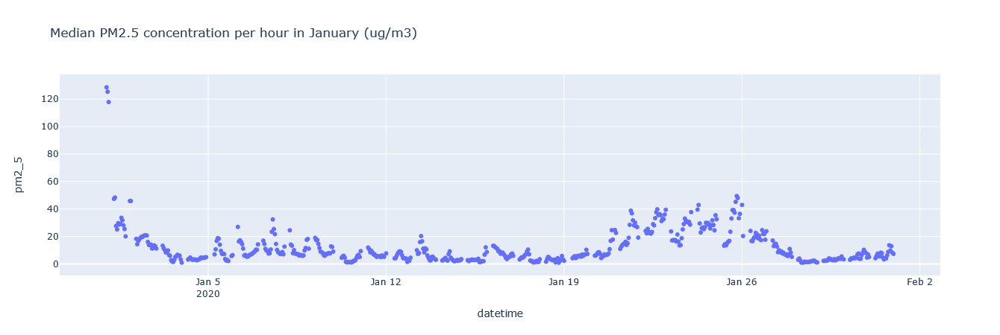

In [38]:
gdf['hour'] = gdf['recording_time'].dt.hour

mean_pm25_date = gdf[["date", "hour", "pm2_5"]].groupby(["date", "hour"]).mean().reset_index()

mean_pm25_date["datetime"] = pd.to_datetime(mean_pm25_date["date"]) + mean_pm25_date["hour"].astype('timedelta64[h]')



fig = px.scatter(mean_pm25_date, x="datetime", y='pm2_5', title='Median PM2.5 concentration per hour in January (ug/m3)')
fig.show()

## Internal/External CV results:

In [16]:
# Open Internal/External CV results:

path = "../output/external_cv/" # use your path
all_files = glob.glob(path + "*.csv")

li = []

for filename in tqdm(all_files):
    df = pd.read_csv(filename, index_col=None, header=0)
    df["resolution"] = pd.to_numeric(filename.split("cv")[2].split(".")[0])
    li.append(df)

frame2 = pd.concat(li, axis=0, ignore_index=True).sort_values("resolution")
frame2 = frame2[~(frame2["resolution"]==125)]

path = "../output/lolocv/" # use your path
all_files = glob.glob(path + "*.csv")

li = []

for filename in tqdm(all_files):
    df = pd.read_csv(filename, index_col=None, header=0)
    df["resolution"] = pd.to_numeric(filename.split("_")[1].split(".")[0])
    li.append(df)

frame3 = pd.concat(li, axis=0, ignore_index=True).sort_values("resolution")

frame3 = frame3[~(frame3["resolution"]==125)]

100%|██████████| 6/6 [00:00<00:00, 68.36it/s]


In [17]:
fig = px.scatter(frame2, x='resolution', y='RMSE', labels={
                "resolution": "Resolution"}, 
                template="plotly_white")

fig.update_traces(marker=dict(size=8))

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 480,
            'width': 640,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }

fig.show(config=config)

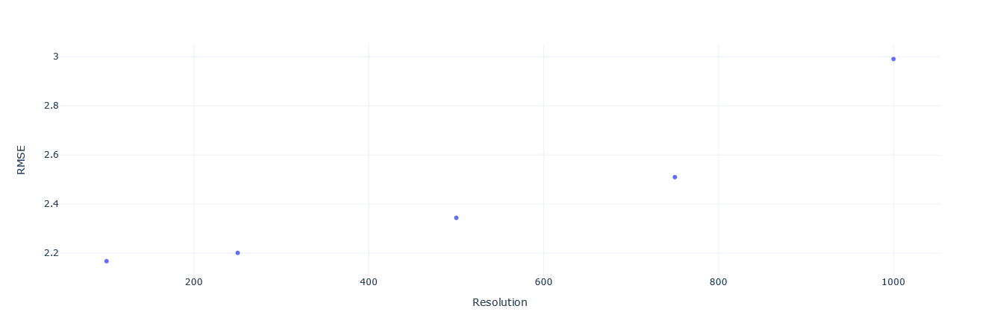

In [65]:
fig = px.scatter(frame3, x='resolution', y='RMSE', labels={
                "resolution": "Resolution"}, 
                template="plotly_white")

fig.update_traces(line=dict(width=2.5))

fig.show(config=config)

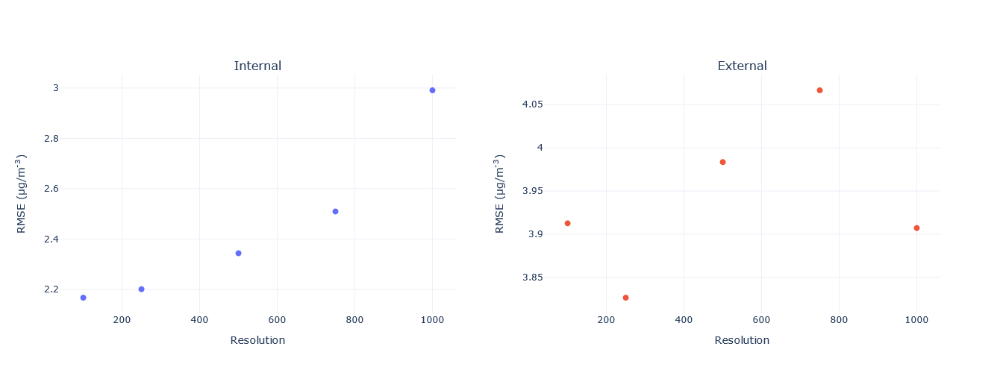

In [36]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2, subplot_titles=("Internal","External"))

fig.add_trace(
    go.Scatter(x=frame3["resolution"], y=frame3["RMSE"], mode="markers", name="External"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=frame2["resolution"], y=frame2["RMSE"], mode="markers", name="External"),
    row=1, col=2
)


fig.update_traces(marker=dict(size=8))

# Update xaxis properties
fig.update_xaxes(title_text="Resolution", row=1, col=1)
fig.update_xaxes(title_text="Resolution", row=1, col=2)

# Update yaxis properties
fig.update_yaxes(title_text="RMSE (μg/m<sup>-3</sup>)", row=1, col=1)
fig.update_yaxes(title_text="RMSE (μg/m<sup>-3</sup>)", row=1, col=2)

fig.update_layout(height=500, width=1000, showlegend=False, template="plotly_white")

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 500,
            'width': 1000,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }

fig.show(config=config)

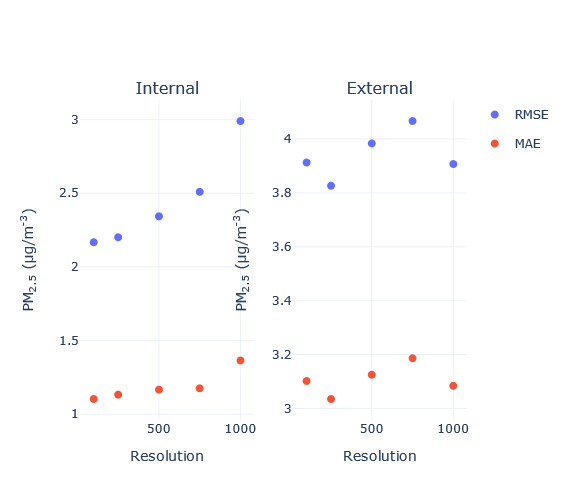

In [51]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2, subplot_titles=("Internal","External"))

fig.add_trace(
    go.Scatter(x=frame3["resolution"], y=frame3["RMSE"], mode="markers", name="RMSE", legendgroup="RMSE"),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(x=frame3["resolution"], y=frame3["MAE"], mode="markers", name="MAE", legendgroup="MAE"),
    row=1, col=1
)




fig.add_trace(
    go.Scatter(x=frame2["resolution"], y=frame2["RMSE"], mode="markers", name="RMSE", legendgroup="RMSE", showlegend=False, marker=dict(color='#636EFA')),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(x=frame2["resolution"], y=frame2["MAE"], mode="markers", name="MAE", legendgroup="MAE", showlegend=False, marker=dict(color='#EF553B')),
    row=1, col=2
)

fig.update_traces(marker=dict(size=8))

# Update xaxis properties
fig.update_xaxes(title_text="Resolution", row=1, col=1)
fig.update_xaxes(title_text="Resolution", row=1, col=2)

# Update yaxis properties
fig.update_yaxes(title_text="PM<sub>2.5</sub> (μg/m<sup>-3</sup>)", row=1, col=1)
fig.update_yaxes(title_text="PM<sub>2.5</sub> (μg/m<sup>-3</sup>)", row=1, col=2)

fig.update_layout(height=500, width=1000, showlegend=True, template="plotly_white")

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 500,
            'width': 1000,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }

fig.show(config=config)

## Data aggregation plots:

In [53]:
path = "../data/processed/vms_grid/total" # use your path
all_files = glob.glob(path + "/*.csv")

li = []

for filename in tqdm(all_files):
    df = pd.read_csv(filename, index_col=None, header=0)
    df["resolution"] = pd.to_numeric(filename.split("_vms")[1].split(".")[0])
    li.append(df)

frame1 = pd.concat(li, axis=0, ignore_index=True)

path = "../data/processed/vms_grid/daily" # use your path
all_files = glob.glob(path + "/*/*.csv")

li = []

for filename in tqdm(all_files):
    df = pd.read_csv(filename, index_col=None, header=0)
    df["resolution"] = filename.split("\\")[1]
    df["resolution"] = df["resolution"].astype(int)
    df["date"] = filename.split("_")[3].split(".")[0]
    df = df.groupby(["resolution", "date"]).mean().reset_index()
    li.append(df)

frame2 = pd.concat(li, axis=0, ignore_index=True)

path = "../data/processed/vms/" # use your path
all_files = glob.glob(path + "*.csv")

li = []

for filename in tqdm(all_files):
    df = pd.read_csv(filename, index_col=None, header=0)
    df["resolution"] = pd.to_numeric(filename.split("_vms")[1].split(".")[0])
    df = df.groupby(["resolution","date"]).mean().reset_index()
    li.append(df)

frame3 = pd.concat(li, axis=0, ignore_index=True)

total_mean = frame1.groupby("resolution").mean().reset_index()
daily_mean = frame2.groupby("resolution").mean().reset_index()
hourly_mean = frame3.groupby("resolution").mean().reset_index().sort_values("resolution")

100%|████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:10<00:00,  1.16s/it]


In [54]:
hourly_mean["time"] = "Hourly"
daily_mean["time"] = "Daily"
total_mean["time"] = "No Temp. Agg."

In [55]:
full = pd.concat([total_mean, daily_mean, hourly_mean], axis=0, ignore_index=True)

In [60]:
hourly_mean = hourly_mean[~(hourly_mean["resolution"]==125)]

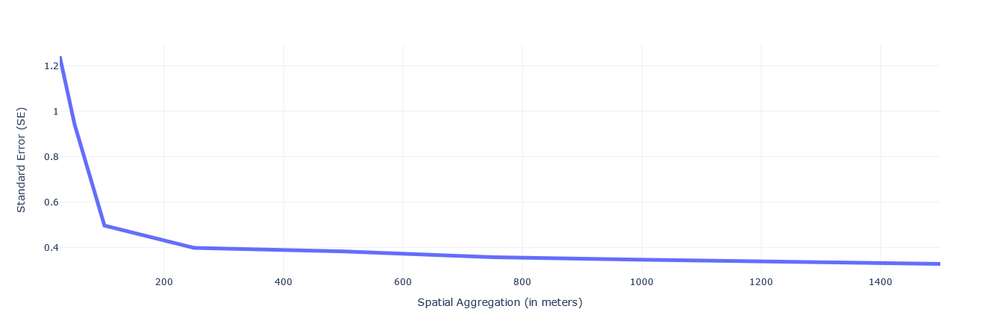

In [61]:
fig = px.line(hourly_mean, x='resolution', y='se', labels={
                "resolution": "Spatial Aggregation (in meters)",  "se": "Standard Error (SE)", "time": "Temporal Aggregation"
            }, template="plotly_white")

fig.update_traces(line=dict(width=5))

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 480,
            'width': 840,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }


fig.show(config=config)


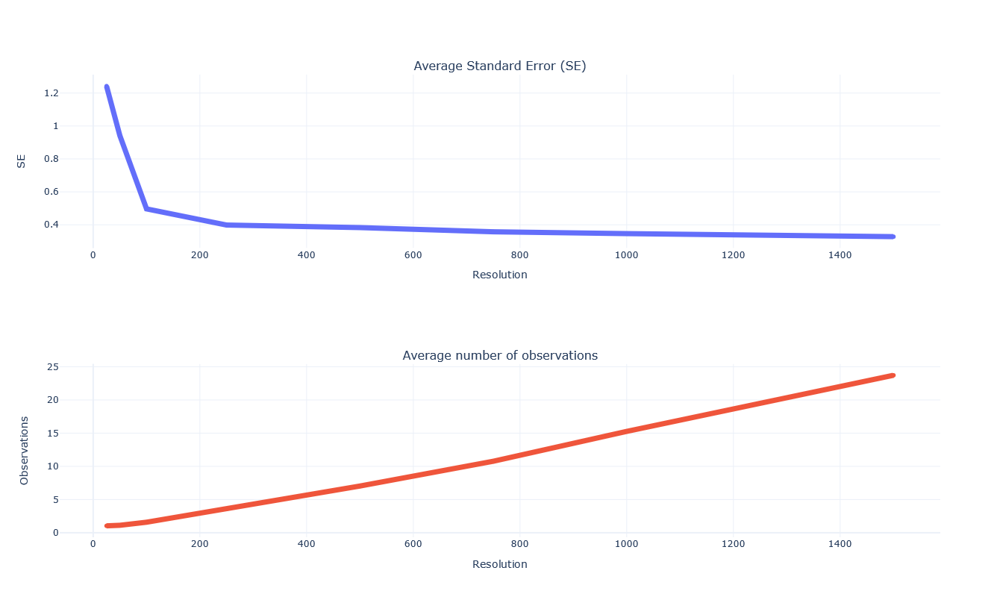

In [62]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=1, subplot_titles=("Average Standard Error (SE)","Average number of observations"))

fig.append_trace(go.Scatter(
    x=hourly_mean["resolution"],
    y=hourly_mean["se"],
), row=1, col=1)

fig.append_trace(go.Scatter(
    x=hourly_mean["resolution"],
    y=hourly_mean["count"],
    #text=round(hourly_mean["count"],2),
    #textposition='top center',
    #mode="lines+markers+text"
), row=2, col=1)

# Update xaxis properties
fig.update_xaxes(title_text="Resolution", row=1, col=1)
fig.update_xaxes(title_text="Resolution", row=2, col=1)

# Update yaxis properties
fig.update_yaxes(title_text="SE", row=1, col=1)
fig.update_yaxes(title_text="Observations", row=2, col=1)

fig.update_traces(line=dict(width=7))

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 800,
            'width': 1200,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }

fig.update_layout(height=800, width=1200, showlegend=False, template="plotly_white")
fig.show(config=config)

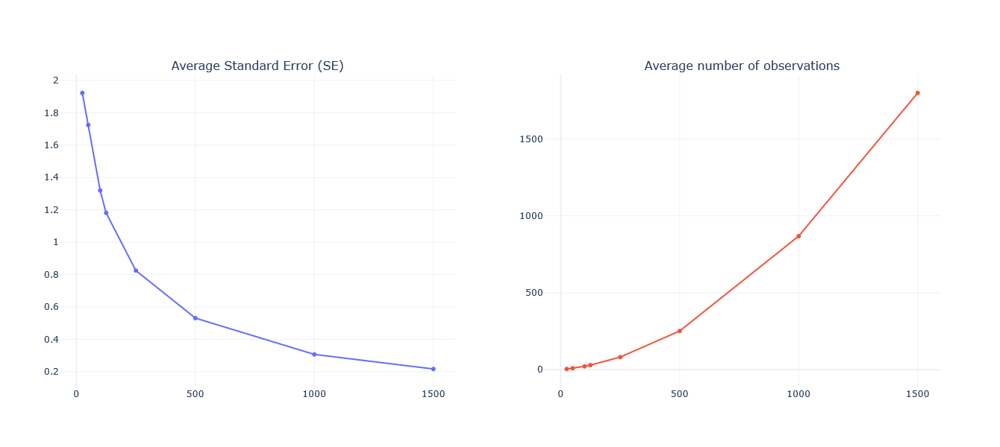

In [29]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2, subplot_titles=("Average Standard Error (SE)","Average number of observations"))

fig.append_trace(go.Scatter(
    x=hourly_mean["resolution"],
    y=hourly_mean["se"],
), row=1, col=1)

fig.append_trace(go.Scatter(
    x=hourly_mean["resolution"],
    y=hourly_mean["count"],
), row=1, col=2)


fig.update_layout(height=600, width=1200, showlegend=False, template="plotly_white")
fig.show()

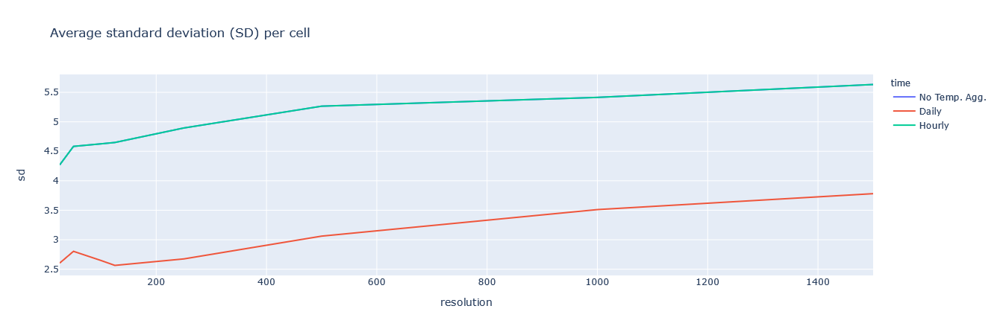

In [15]:
fig = px.line(full, x='resolution', y='sd', color="time", title='Average standard deviation (SD) per cell')
fig.show()

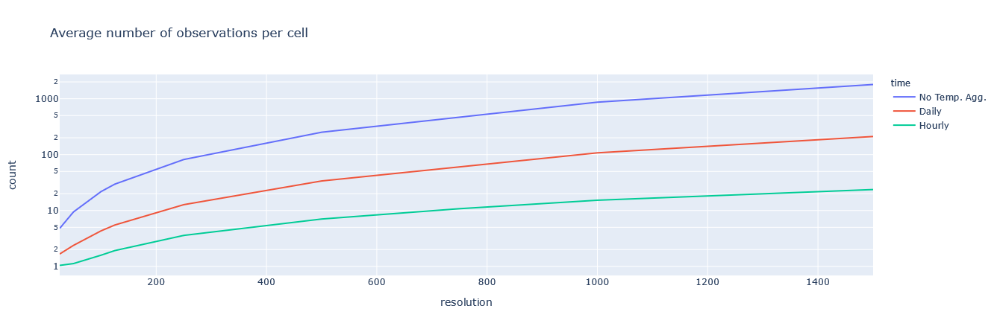

In [82]:
fig = px.line(full, x='resolution', y='count', color="time", title='Average number of observations per cell', log_y=True)
fig.show()

## Extra: Internal CV Error plots

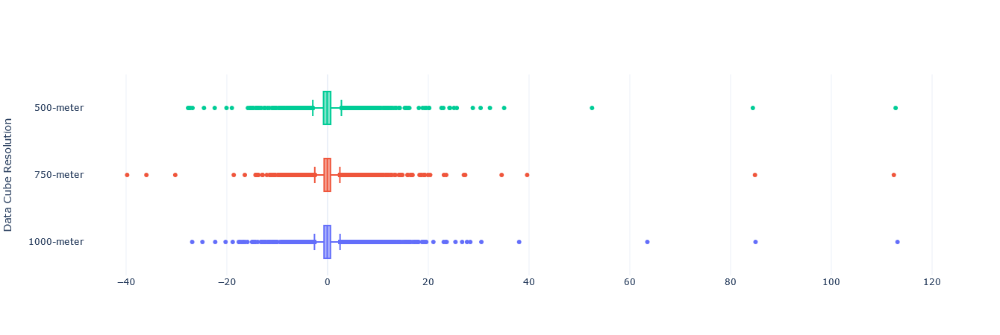

In [139]:
import plotly.graph_objects as go
import numpy as np

x1 = pd.read_csv('../output/lolocv/errors\\error500-2.csv', index_col=None, header=0)["x"].values.tolist()
x2 = pd.read_csv('../output/lolocv/errors\\error750-2.csv', index_col=None, header=0)["x"].values.tolist()
x3 = pd.read_csv('../output/lolocv/errors\\error1000-2.csv', index_col=None, header=0)["x"].values.tolist()

fig = go.Figure()
# Use x instead of y argument for horizontal plot
fig.add_trace(go.Box(x=x1, name="1000-meter"))
fig.add_trace(go.Box(x=x2, name="750-meter"))
fig.add_trace(go.Box(x=x3, name="500-meter"))
fig.update_yaxes(title_text="Data Cube Resolution")

fig.update_layout(
    template="plotly_white",
    showlegend=False
)

config = {
        'toImageButtonOptions': {
            'format': 'png', # one of png, svg, jpeg, webp
            'height': 480,
            'width': 840,
            'scale': 2 # Multiply title/legend/axis/canvas sizes by this factor
        }
    }


fig.show(config=config)

In [19]:
# Median Absolute Error (MedAE)
x1 = pd.read_csv('../output/lolocv/errors\\error500.csv', index_col=None, header=0)["x"]
x2 = pd.read_csv('../output/lolocv/errors\\error750.csv', index_col=None, header=0)["x"]
x3 = pd.read_csv('../output/lolocv/errors\\error1000.csv', index_col=None, header=0)["x"]

[x1.abs().median(), x2.abs().median(), x3.abs().median()]

[0.640635479052163, 0.622565071254075, 0.723299650174619]